<a href="https://colab.research.google.com/github/Bambillo1/elecomsCoding_academy/blob/main/Segmentation_of_Flood_Risk_Area_With_Deep_Neural_Network_and_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Image Segmentation: Flood Area Segmentation
One of the most important operations in Computer Vision is Segmentation. Image segmentation is the process of dividing an image into multiple parts or regions that belong to the same class. This task of clustering is based on specific criteria, for example, color or texture. This process is also called pixel-level classification. In other words, it involves partitioning images (or video frames) into multiple segments or objects.
Read more at: https://viso.ai/deep-learning/image-segmentation-using-deep-learning/

#Title: Segmentation of Flood Risk Areas using Semantic Segmentation with DeepLabV3 and ResNet50

**Abstract:**

Flood risk management is a critical aspect of disaster preparedness and response. In this research work, we propose a state-of-the-art approach for the precise segmentation of flood risk areas using semantic segmentation techniques. Leveraging the power of convolutional neural networks (ConvNets) and the DeepLabV3 model with a pre-trained ResNet50 backbone, we aim to accurately identify regions at risk of flooding.

Our methodology incorporates ConvBlock, an innovative custom layer that enhances feature extraction, and the Atrous Spatial Pyramid Pooling (ASPP) module for capturing multi-scale contextual information. These components work in synergy to optimize the network's ability to understand and delineate flood risk areas within high-resolution satellite images.

The performance of our model is evaluated on a comprehensive dataset of flood-affected regions, where the proposed DeepLabV3 architecture demonstrates its capability to achieve an impressive test accuracy of 89%. This level of accuracy is vital for emergency response teams, urban planners, and policymakers in making informed decisions regarding disaster management and mitigation strategies.

Our research provides a significant contribution to the field of flood risk assessment by combining cutting-edge deep learning techniques with semantic segmentation. The segmentation maps produced by our model can serve as valuable resources for early warning systems and flood risk monitoring. This work ultimately advances the cause of disaster resilience and underscores the potential of artificial intelligence in addressing critical challenges in the domain of environmental management.






In [2]:
#Clear the output of the current cell receiving output
from IPython.display import clear_output as cls

!pip install tf_explain

# For formatting
cls()

In [3]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data
from tqdm import tqdm
from glob import glob
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visualization
import matplotlib.pyplot as plt

# Model Layers
from keras.models import Model
from keras.layers import Layer
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU, ReLU
from keras.models import Sequential

# Backbone
from tensorflow.keras.applications import ResNet50

# Model Architecture Visualization
from tensorflow.keras.utils import plot_model

# Optimizer
from tensorflow.keras.optimizers import Adam

# Callbacks
from keras.callbacks import ModelCheckpoint, Callback

# Model Layer Visualization
from tf_explain.core.grad_cam import GradCAM

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [5]:
!gdown --id 1o61qmK8QTSYxagRtca5U6sDGuvj4yHdQ

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1o61qmK8QTSYxagRtca5U6sDGuvj4yHdQ
To: /content/flood_area_segmentation.zip
100% 112M/112M [00:01<00:00, 59.7MB/s]


In [6]:
from zipfile import ZipFile
file_name = 'flood_area_segmentation.zip'
with ZipFile(file_name, 'r') as file:
  file.extractall()
  print('Done with extraction')

Done with extraction


In [7]:
# Specify paths
root_path = './'
image_path = './Image/'
mask_path = './Mask/'
metadata_path = "./metadata.csv"

In [17]:
# Load file
metadata = pd.read_csv(metadata_path)

print(metadata)

        Image      Mask
0       0.jpg     0.png
1       1.jpg     1.png
2       2.jpg     2.png
3       3.jpg     3.png
4       4.jpg     4.png
..        ...       ...
285  1083.jpg  1083.png
286  1084.jpg  1084.png
287  1085.jpg  1085.png
288  1086.jpg  1086.png
289  1087.jpg  1087.png

[290 rows x 2 columns]


In [18]:
# This is a helper function
def load_image(path:str, SIZE:tuple = (256, 256), mask:bool = False):

    '''
    This function is responsible for loading and processing the image. The function takes in the path of the
    image to be loaded and then loads the image using OpenCV, perform a resize conversionn and cast the image
    to a 32Bit Float Tensor. At last, the image is normalized to change the pixel range from 0 to 255 to
    0 to 1.

    Inputs :
        path : It represents the file path of he image to be loaded.
        size : The desired size in which the image should be resized, default is set to 256 x 256 pixels.
        mask : If the image to be loaded is then the image is a binary map i.e of shape = (*size, 1)

    Output:
        image : The processed image whose file path was provided.
    '''

    # load Image
    image = load_img(path)

    # Convert to an array
    image = img_to_array(image)

    # Resize the image
    image = tfi.resize(image, SIZE)

    # Convert to Tensor of 32Bit - Float
    image = tf.cast(image, tf.float32)

    # Normalize the image
    image = image/255.

    # Mask
    if mask:
        image = image[:, :, :1]

    # return image
    return image

In [19]:
def load_data(root_path:str=root_path):

    '''
    The function is reponsible for loading all the Images and their respective Masks. It does so by first load the file paths of the Images
    then it applies some changes on the Image paths to convert them to Mask Paths. Before loading the Images and Masks, first a empty space
    is created, where the loaded Images and Masks are stored. As last it returns the array of Images and Masks.

    Input :
        root_path : The path to the main directory where both the images & masks are kept.

    Outputs :
        images : Array of all the images present in the data set.
        masks : Array of all the masks present in the data set.
    '''

    # Load the Image and Mask paths
    image_paths = sorted(glob(root_path + "Image/*.jpg"))
    mask_paths  = [path.replace("Image", "Mask").replace("jpg", "png") for path in image_paths]

    # Create space for loading the images and masks
    images = np.empty(shape=(len(image_paths), 256, 256, 3), dtype=np.float32)
    masks  = np.empty(shape=(len(image_paths), 256, 256, 1), dtype=np.float32)

    # load the images and masks
    for i, (img_path, mask_path) in tqdm(enumerate(zip(image_paths, mask_paths)), desc="Loading"):

        # Load the image
        image = load_image(path = img_path, mask = False)

        # Load the respective mask
        mask  = load_image(path = mask_path, mask = True)

        # Put this into the Space
        images[i] = image
        masks[i]  = mask

    # Return the images and Masks
    return images, masks

In [20]:
# Collect all images and masks
all_images, all_masks = load_data(root_path)

Loading: 290it [00:28, 10.13it/s]


In [21]:
# Split data into Training and Testing
data_len = len(all_images)

# Training set
train_images, train_masks = all_images[:int(data_len*0.8)], all_masks[:int(data_len*0.8)]

# Testing Set
test_images,  test_masks = all_images[int(data_len*0.8):], all_masks[int(data_len*0.8):]

In [22]:
def show_images(images, masks, n_images, SIZE=(15,8)) -> None:

    '''
    This function is responsible for visualising N number of images from the given set of Images and the respective masks.
    It does so by plotting the images and masks using matplotlib.

    Inputs :
        images   : The collection of images.
        masks    : The collection of masks.
        n_images : Total number of images to be plotted.
        SIZE     : Size of each plot.

    '''

    # Plot n Images
    for i in range(n_images):

        # Plotting Configuration
        plt.figure(figsize=SIZE)

        # Select a image Randomly
        id = np.random.randint(len(images))

        # Plot the Image
        plt.subplot(1, 3, 1)
        plt.imshow(images[id])
        plt.title("Image")
        plt.axis('off')

        # Plot the Mask
        plt.subplot(1, 3, 2)
        plt.imshow(masks[id], cmap='gray')
        plt.title("Mask")
        plt.axis('off')

        # Plot the Overlapping Mask
        plt.subplot(1, 3, 3)
        plt.imshow(images[id], cmap='gray')
        plt.imshow(masks[id], cmap='gray', alpha=0.5)
        plt.title("Overlapping Mask")
        plt.axis('off')

        # Shwo a Single Frame : This is done to speed up plotting for large number images
        plt.tight_layout()
        plt.show()

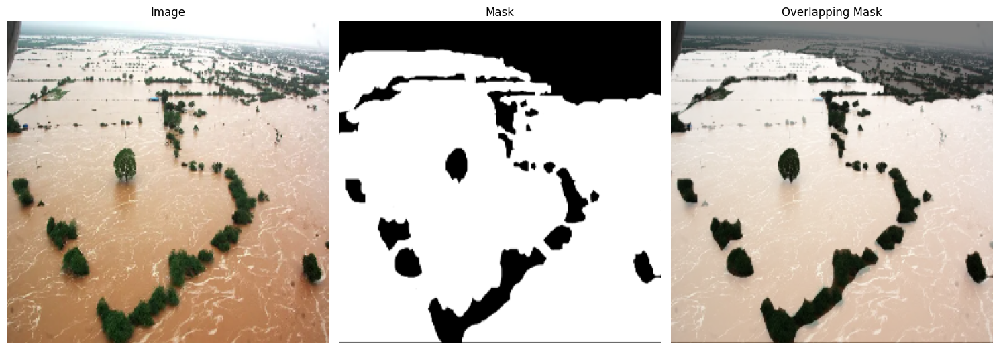

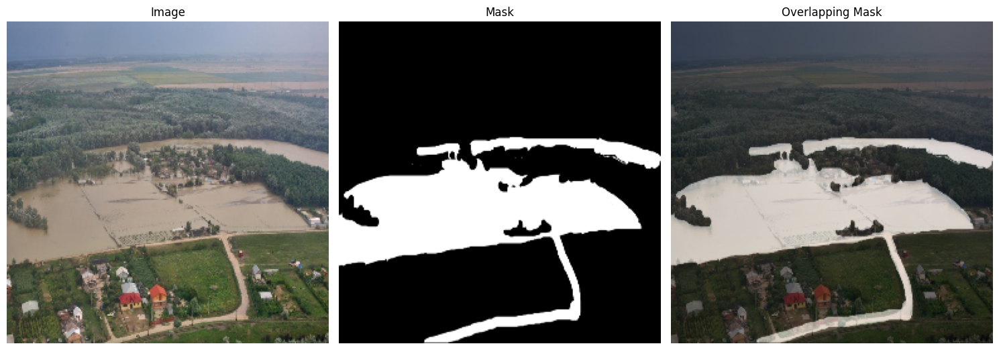

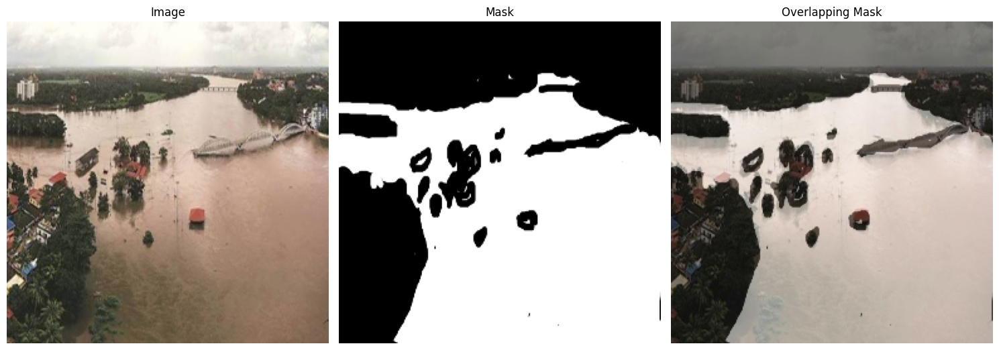

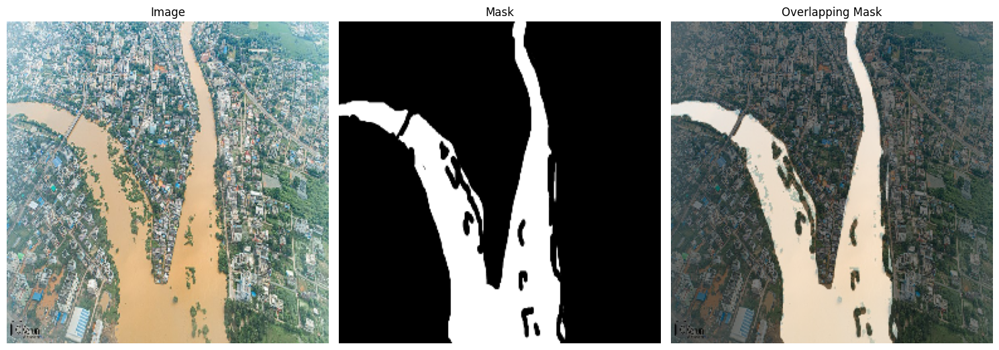

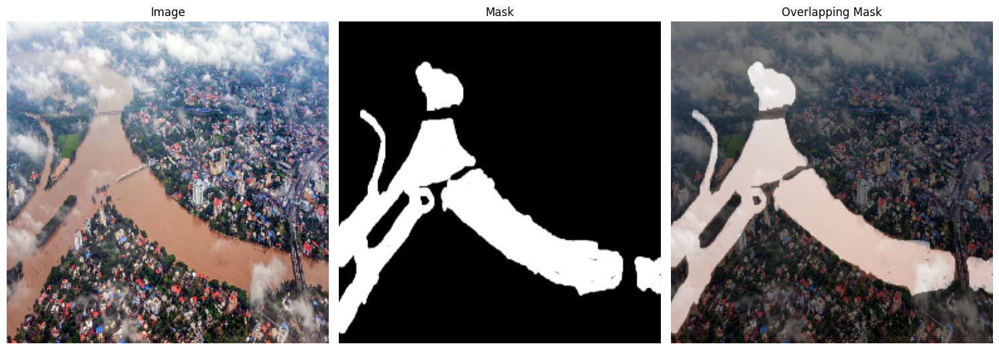

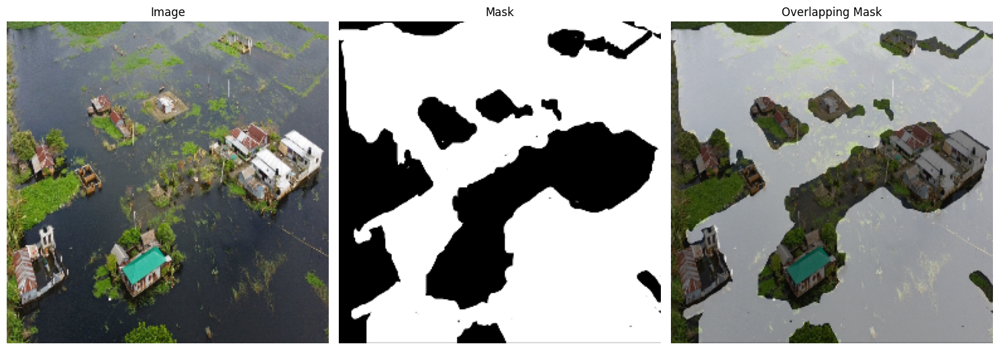

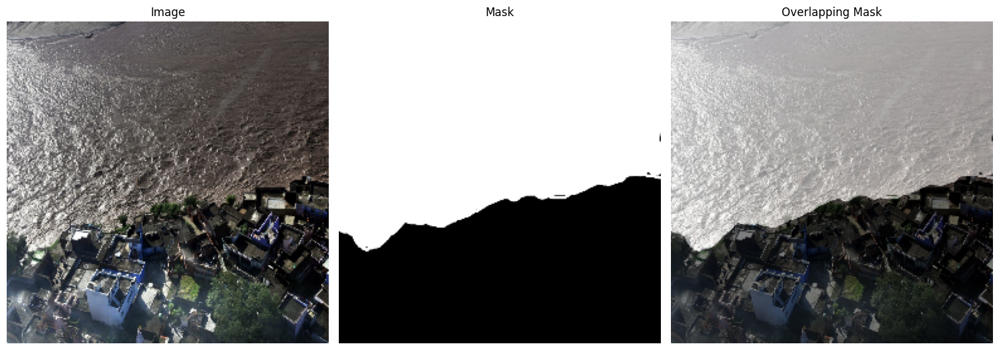

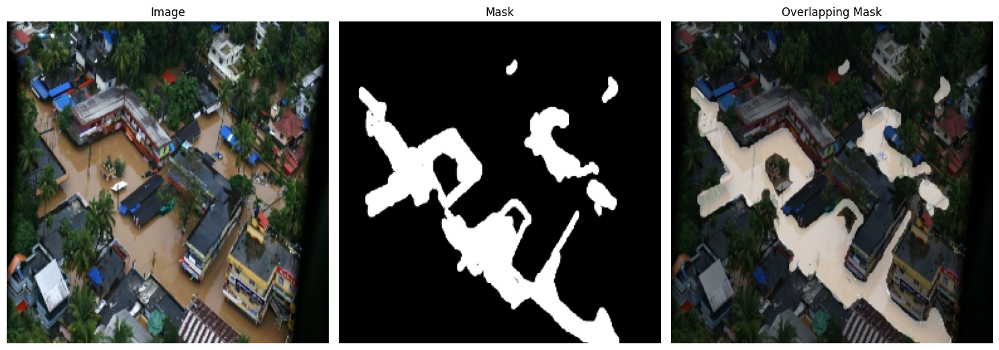

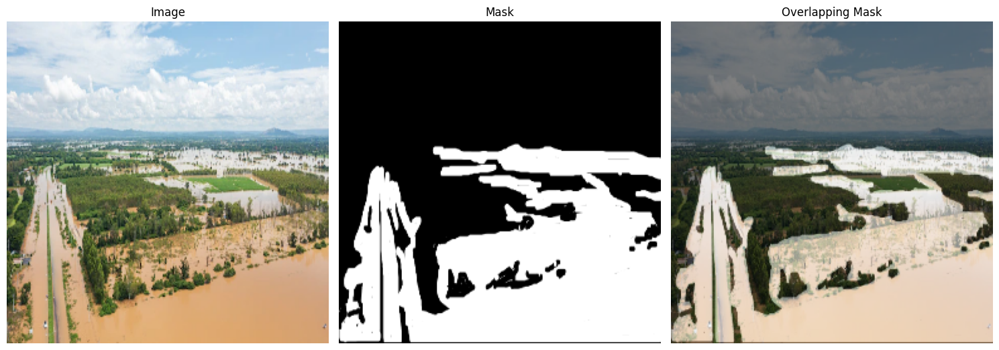

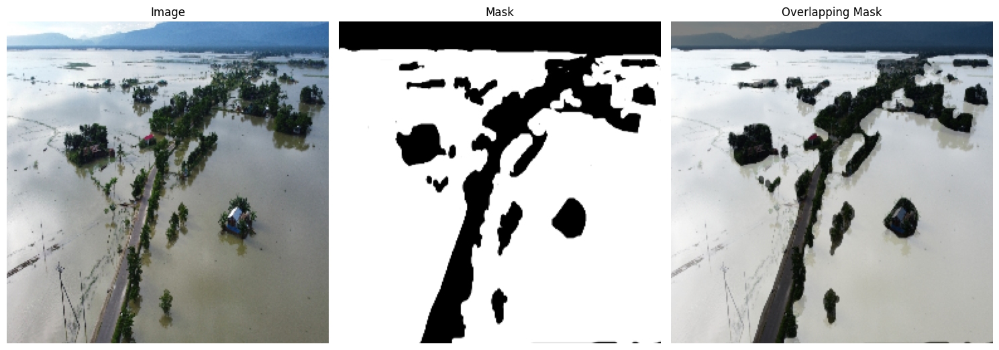

In [23]:
show_images(train_images, train_masks, n_images=10)

Because objects could appear in an image in a variety of locations, the standard neural network architecture—an input layer, a few dense layers, and an output layer—does not perform well for image identification applications. Thus, adding one or more convolutional layers is the solution.

A convolutional neural network (CNN) uses convolutional blocks as building blocks to recognize images. Convolutional layers, which make up its composition, are employed to extract characteristics from the input image. One or more pooling layers, which are intended to minimize the spatial dimensions of the feature maps while maintaining the most crucial information, usually come after the convolutional layers.



A convolutional block's fundamental composition is as follows:

After the input image has passed through one or more convolutional layers, features like edges, textures, and forms are extracted from the image by applying filters.
The feature maps are down-sampled by passing the output of the convolutional layers through one or more pooling layers. As a result, the feature maps' spatial dimensions are decreased, improving the network's computational efficiency and lowering the chance of overfitting.
One or more fully connected layers are then applied to the output of the pooling layers in order to classify or forecast the image.

In the early phases of a CNN, where the main objective is to extract features from the input image, convolutional blocks are used. In the network, they are usually repeated several times, with each block obtaining increasingly intricate properties from the output of the preceding block. The network can learn more intricate features because to its hierarchical structure, which enhances picture recognition capabilities.


In [24]:
class ConvBlock(Layer):

    '''
    As in the Model implementation uses, Conv2D -> BatchNormalization -> ReLU. In the same fashion again and again, that why we have created a Single Layer
    which apply this operation. So ConvBlock = Conv2D -> BatchNormalization -> ReLU. This helps us in implementation.
    '''

    def __init__(self, filters:int = 256, kernel_size:int = 3, dilation_rate:int = 1, **kwargs) -> None:
        super(ConvBlock, self).__init__(**kwargs)

        # Define Parameters
        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        # Define the model
        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', strides=1, dilation_rate=dilation_rate, activation=None, use_bias=False),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        # Apply the layers
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()

        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate
        }

#Structure of Atrous Spatial Pyramid Pooling (ASPP) Module
Atrous Spatial Pyramid Pooling (ASPP) is a semantic segmentation module for resampling a given feature layer at multiple rates prior to convolution. Put more simply, it enables us to examine a picture at various sizes and through various filters, enabling precise object detection and further contextual data extraction from the picture.

Several parallel atrous convolutional layers, each with a different sampling rate, are used in this technique. By doing this, we may capture objects of various sizes and distances from the camera, as ASPP can accomplish a wider range of coverage throughout the image than simply employing a single filter.

Because ASPP enables us to extract additional information from an image, it is crucial for image recognition jobs as it can result in more precise and superior object detection. We can catch objects that might be too little or too far away to be recognized with a single filter by evaluating an image at several scales.

Additionally, ASPP can aid in object shape prediction by capturing additional context around an object and aiding in its separation from the backdrop. This is important for situations where successful prediction depends on object shape and context, including autonomous car navigation or medical image analysis.

Applications including Flood segmentation

There are several uses for ASPP, particularly in computer vision and image recognition. In autonomous vehicles, such self-driving cars or drones, object identification and context are essential for precise and safe navigation. This makes autonomous vehicle applications one of the most promising uses of ASPP.

Additionally, ASPP can be applied to medical image analysis, where it might be useful for tasks like organ or tissue segmentation and diagnosis. Additional uses for ASPP include augmented reality and video surveillance, where it can assist with real-time object recognition and tracking as well as the detection and monitoring of things of interest.



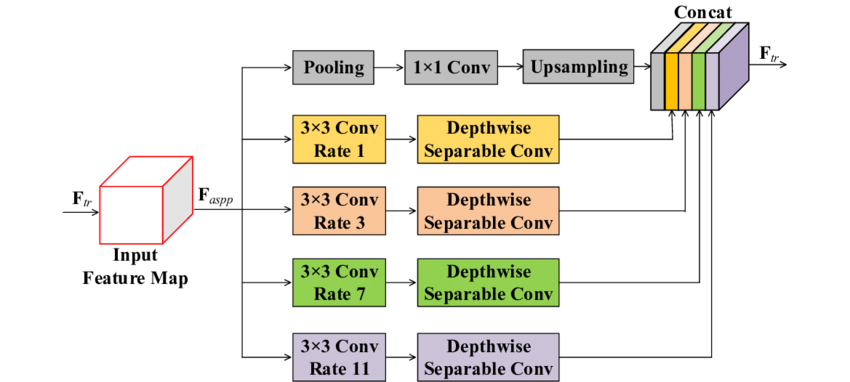

In [25]:
def AtrousSpatialPyramidPooling(X):

    # Shape
    _, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-ImagePool-AP")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[1]), name="ASPP-ImagePool-US")(image_pool)

    # Astrous Layers
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-Conv1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-Conv6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-Conv12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-Conv18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Concatenate")([image_pool, conv_1, conv_6, conv_12, conv_18])
    output = ConvBlock(kernel_size=1, name="ASPP-Out")(combined)

    return output

#DeepLabV3DeepLabv3_ResNet50 features include:

Since it uses the ResNet50 backbone, it is pre-trained on ImageNet and has a good ability to extract image features. It uses the Atrous Spatial Pyramid Pooling (ASPP) module, which allows it to detect objects of various sizes. We use Deep Supervision to improve the learning stability of our model. In addition to semantic segmentation tasks, DeepLabv3_ResNet50 can also be used for tasks such as instance segmentation, object detection, and image classification.

In [26]:
# Model Specifications
IMAGE_SIZE = 256
MODEL_NAME = "DeepLab-FloodArea"

# Input Layer
inputs = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Backbone
backbone = ResNet50(input_tensor=inputs, weights='imagenet', include_top=False)

# High Level Features
DCNN = backbone.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(
    IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]
), name="ASPP-UpSample-Out")(ASPP)

# Low Level Features
LLF = backbone.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combine
concat = Concatenate(axis=-1, name="Concat-LLF-HLF")([LLF, ASPP])
y = ConvBlock(name="TopConvBlock1")(concat)
y = ConvBlock(name="TopConvBlock2")(y)
y = UpSampling2D(size=(
    IMAGE_SIZE//y.shape[1], IMAGE_SIZE//y.shape[2]
), name="Feature-UpSample")(y)

# Output Layer
output = Conv2D(filters=1, kernel_size=3, padding='same', activation='sigmoid', use_bias=False, name="OutputLayer")(y)

# Model
DeepLabV3 = Model(inputs, output, name=MODEL_NAME)

94765736/94765736 [==============================] - 3s 0us/step


In [27]:
DeepLabV3.summary()

Model: "DeepLab-FloodArea"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 262, 262, 3)          0         ['InputLayer[0][0]']          
                                                                                                  
 conv1_conv (Conv2D)         (None, 128, 128, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                              

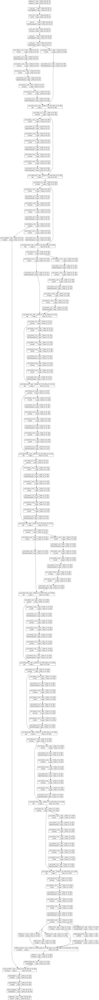

In [28]:
plot_model(DeepLabV3, MODEL_NAME+".png", dpi=96, show_shapes=True)

#This helper function displays predicted masks in comparison to original images and GradCAM

In [32]:
def show_model_preds(images, masks, model, SIZE:tuple = (15,8)) -> None:
    # Collect Image and Mask
    id = np.random.randint(len(test_images))
    image, mask = images[id], masks[id]

    # Make Prediction
    pred_mask = model.predict(tf.expand_dims(image, axis=0))
    #eval_pred_mask = model.evaluate(pred_mask, all_images)

    # Grad CAM
    cam = GradCAM()
    capture = cam.explain(
        validation_data=(tf.expand_dims(image, axis=0).numpy(), mask),
        model=model,
        class_index=1,
        layer_name="TopConvBlock2"
    )

    # Plot Size
    plt.figure(figsize=SIZE)

    # Plot Image
    plt.subplot(1,4,1)
    plt.imshow(image)
    plt.title("Input Image")
    plt.axis('off')

    # Plot Original Mask
    plt.subplot(1,4,2)
    plt.title("Expected Mask")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    # Plot Predicted Mask
    plt.subplot(1,4,3)
    plt.imshow(tf.squeeze(pred_mask), cmap='gray')
    plt.title("Predicted Mask")
    plt.axis('off')

    # Grad CAM
    plt.subplot(1,4,4)
    plt.title("Grad CAM Visualization")
    plt.imshow(tf.squeeze(capture))
    plt.axis('off')

    # Show the Final Plot
    plt.show()

#Creating a class for callback during training

In [33]:
class ShowProgress(Callback):

    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_model_preds(test_images, test_masks, self.model)

#Compiling and training of DeepLabV3

Epoch 1/100
29/29 [==============================] - ETA: 0s - loss: 0.0493 - accuracy: 0.9621

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


29/29 [==============================] - 45s 451ms/step - loss: 0.0493 - accuracy: 0.9621 - val_loss: 0.3911 - val_accuracy: 0.8908
Epoch 2/100
29/29 [==============================] - 8s 289ms/step - loss: 0.0542 - accuracy: 0.9604 - val_loss: 0.3779 - val_accuracy: 0.8962
Epoch 3/100
29/29 [==============================] - 7s 236ms/step - loss: 0.0498 - accuracy: 0.9620 - val_loss: 0.3882 - val_accuracy: 0.8989
Epoch 4/100
29/29 [==============================] - 8s 275ms/step - loss: 0.0478 - accuracy: 0.9626 - val_loss: 0.3562 - val_accuracy: 0.8980
Epoch 5/100
29/29 [==============================] - 6s 224ms/step - loss: 0.0496 - accuracy: 0.9621 - val_loss: 0.4341 - val_accuracy: 0.8878
Epoch 6/100
29/29 [==============================] - 7s 256ms/step - loss: 0.1280 - accuracy: 0.9330 - val_loss: 0.7136 - val_accuracy: 0.8165
Epoch 7/100
29/29 [==============================] - 7s 244ms/step - loss: 0.1117 - accuracy: 0.9397 - val_loss: 0.6043 - val_accuracy: 0.8681
Epoch 8/10

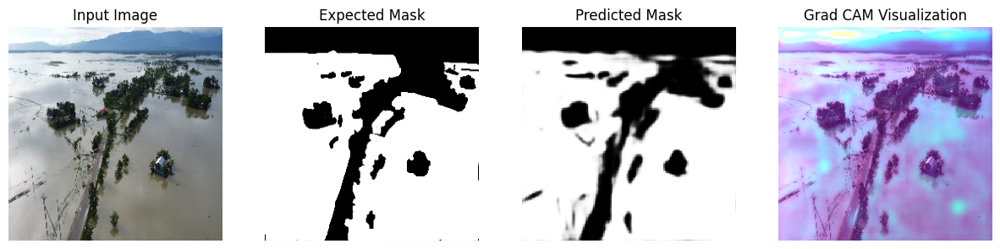

29/29 [==============================] - 11s 380ms/step - loss: 0.0503 - accuracy: 0.9619 - val_loss: 0.3055 - val_accuracy: 0.8978
Epoch 11/100
29/29 [==============================] - 7s 227ms/step - loss: 0.0458 - accuracy: 0.9635 - val_loss: 0.3214 - val_accuracy: 0.8976
Epoch 12/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0450 - accuracy: 0.9639 - val_loss: 0.3195 - val_accuracy: 0.8970
Epoch 13/100
29/29 [==============================] - 6s 222ms/step - loss: 0.0450 - accuracy: 0.9641 - val_loss: 0.3158 - val_accuracy: 0.8987
Epoch 14/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0426 - accuracy: 0.9646 - val_loss: 0.3234 - val_accuracy: 0.8998
Epoch 15/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0416 - accuracy: 0.9649 - val_loss: 0.3297 - val_accuracy: 0.8983
Epoch 16/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0408 - accuracy: 0.9651 - val_loss: 0.3286 - val_accuracy: 0.9009
Epoc

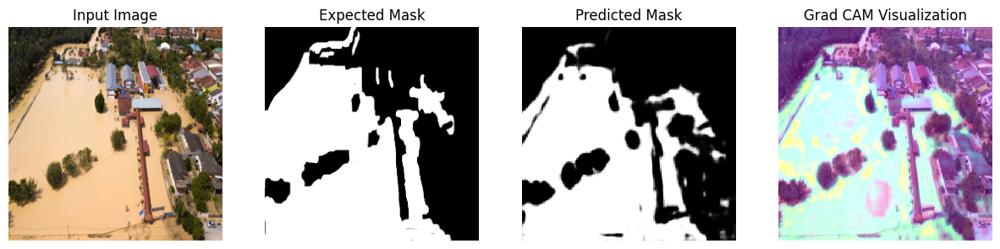

29/29 [==============================] - 8s 266ms/step - loss: 0.0392 - accuracy: 0.9656 - val_loss: 0.3479 - val_accuracy: 0.9011
Epoch 21/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0391 - accuracy: 0.9656 - val_loss: 0.3614 - val_accuracy: 0.8955
Epoch 22/100
29/29 [==============================] - 6s 224ms/step - loss: 0.0389 - accuracy: 0.9657 - val_loss: 0.3571 - val_accuracy: 0.8992
Epoch 23/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0386 - accuracy: 0.9658 - val_loss: 0.3762 - val_accuracy: 0.8999
Epoch 24/100
29/29 [==============================] - 6s 225ms/step - loss: 0.0376 - accuracy: 0.9661 - val_loss: 0.3826 - val_accuracy: 0.8995
Epoch 25/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0373 - accuracy: 0.9662 - val_loss: 0.3754 - val_accuracy: 0.8996
Epoch 26/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0372 - accuracy: 0.9663 - val_loss: 0.3938 - val_accuracy: 0.8988
Epoch

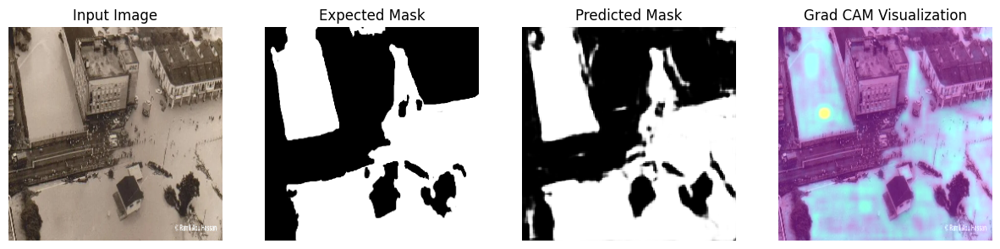

29/29 [==============================] - 7s 257ms/step - loss: 0.0367 - accuracy: 0.9663 - val_loss: 0.3864 - val_accuracy: 0.8978
Epoch 31/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0374 - accuracy: 0.9662 - val_loss: 0.4130 - val_accuracy: 0.8980
Epoch 32/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0380 - accuracy: 0.9660 - val_loss: 0.4010 - val_accuracy: 0.8986
Epoch 33/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0388 - accuracy: 0.9657 - val_loss: 0.3640 - val_accuracy: 0.9013
Epoch 34/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0392 - accuracy: 0.9655 - val_loss: 0.3849 - val_accuracy: 0.8995
Epoch 35/100
29/29 [==============================] - 7s 231ms/step - loss: 0.0387 - accuracy: 0.9656 - val_loss: 0.3587 - val_accuracy: 0.9009
Epoch 36/100
29/29 [==============================] - 7s 230ms/step - loss: 0.0377 - accuracy: 0.9660 - val_loss: 0.3738 - val_accuracy: 0.8993
Epoch

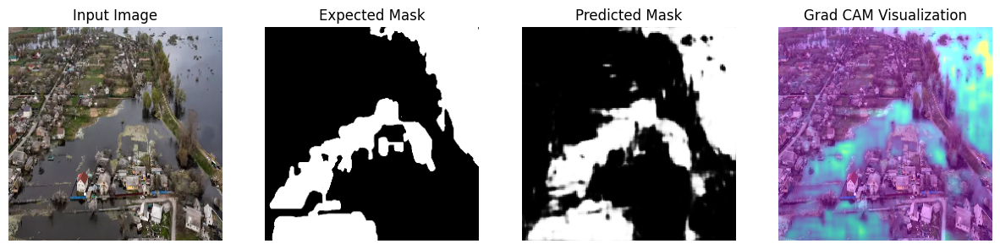

29/29 [==============================] - 7s 257ms/step - loss: 0.0355 - accuracy: 0.9667 - val_loss: 0.3950 - val_accuracy: 0.8998
Epoch 41/100
29/29 [==============================] - 7s 225ms/step - loss: 0.0348 - accuracy: 0.9670 - val_loss: 0.4136 - val_accuracy: 0.8991
Epoch 42/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0351 - accuracy: 0.9668 - val_loss: 0.4130 - val_accuracy: 0.9010
Epoch 43/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0352 - accuracy: 0.9667 - val_loss: 0.4099 - val_accuracy: 0.9000
Epoch 44/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0347 - accuracy: 0.9669 - val_loss: 0.4208 - val_accuracy: 0.8994
Epoch 45/100
29/29 [==============================] - 7s 227ms/step - loss: 0.0342 - accuracy: 0.9670 - val_loss: 0.4060 - val_accuracy: 0.9002
Epoch 46/100
29/29 [==============================] - 7s 230ms/step - loss: 0.0342 - accuracy: 0.9671 - val_loss: 0.4067 - val_accuracy: 0.9015
Epoch

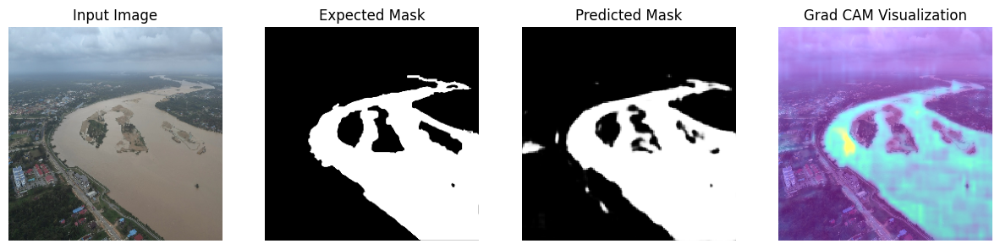

29/29 [==============================] - 8s 261ms/step - loss: 0.0339 - accuracy: 0.9671 - val_loss: 0.4178 - val_accuracy: 0.8991
Epoch 51/100
29/29 [==============================] - 7s 231ms/step - loss: 0.0338 - accuracy: 0.9672 - val_loss: 0.4340 - val_accuracy: 0.8994
Epoch 52/100
29/29 [==============================] - 7s 229ms/step - loss: 0.0341 - accuracy: 0.9671 - val_loss: 0.4365 - val_accuracy: 0.8986
Epoch 53/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0345 - accuracy: 0.9669 - val_loss: 0.4339 - val_accuracy: 0.8965
Epoch 54/100
29/29 [==============================] - 7s 230ms/step - loss: 0.0343 - accuracy: 0.9670 - val_loss: 0.4179 - val_accuracy: 0.8991
Epoch 55/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0346 - accuracy: 0.9668 - val_loss: 0.4288 - val_accuracy: 0.8971
Epoch 56/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0342 - accuracy: 0.9671 - val_loss: 0.4518 - val_accuracy: 0.8978
Epoch

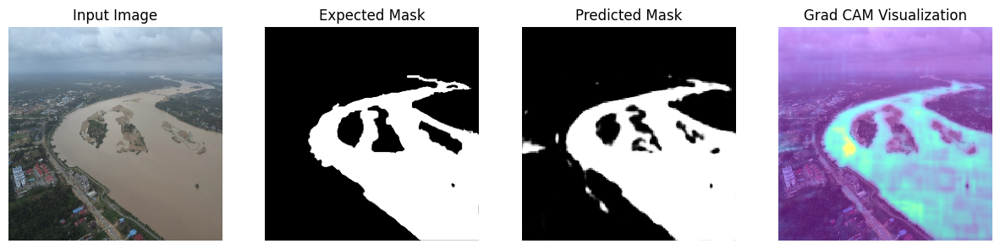

29/29 [==============================] - 7s 255ms/step - loss: 0.0337 - accuracy: 0.9672 - val_loss: 0.4321 - val_accuracy: 0.8970
Epoch 61/100
29/29 [==============================] - 7s 225ms/step - loss: 0.0334 - accuracy: 0.9672 - val_loss: 0.4202 - val_accuracy: 0.8984
Epoch 62/100
29/29 [==============================] - 7s 228ms/step - loss: 0.0338 - accuracy: 0.9671 - val_loss: 0.4459 - val_accuracy: 0.8997
Epoch 63/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0341 - accuracy: 0.9671 - val_loss: 0.4132 - val_accuracy: 0.8982
Epoch 64/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0332 - accuracy: 0.9672 - val_loss: 0.4329 - val_accuracy: 0.8968
Epoch 65/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0327 - accuracy: 0.9675 - val_loss: 0.4391 - val_accuracy: 0.8998
Epoch 66/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0324 - accuracy: 0.9675 - val_loss: 0.4272 - val_accuracy: 0.8971
Epoch

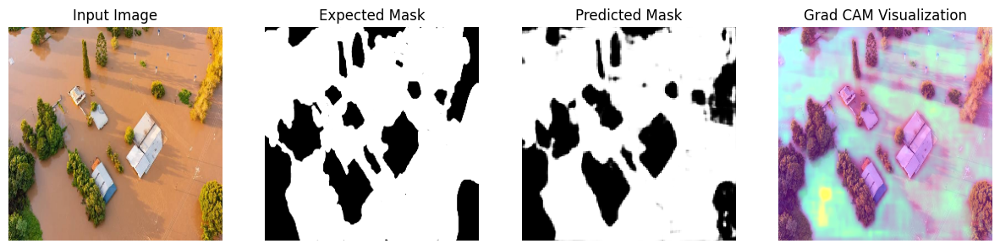

29/29 [==============================] - 7s 258ms/step - loss: 0.0332 - accuracy: 0.9674 - val_loss: 0.4698 - val_accuracy: 0.9004
Epoch 71/100
29/29 [==============================] - 7s 227ms/step - loss: 0.0328 - accuracy: 0.9674 - val_loss: 0.4376 - val_accuracy: 0.8993
Epoch 72/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0329 - accuracy: 0.9673 - val_loss: 0.4846 - val_accuracy: 0.8979
Epoch 73/100
29/29 [==============================] - 7s 235ms/step - loss: 0.0329 - accuracy: 0.9674 - val_loss: 0.4287 - val_accuracy: 0.8984
Epoch 74/100
29/29 [==============================] - 7s 225ms/step - loss: 0.0329 - accuracy: 0.9674 - val_loss: 0.4417 - val_accuracy: 0.8982
Epoch 75/100
29/29 [==============================] - 7s 234ms/step - loss: 0.0327 - accuracy: 0.9674 - val_loss: 0.4466 - val_accuracy: 0.8980
Epoch 76/100
29/29 [==============================] - 7s 232ms/step - loss: 0.0331 - accuracy: 0.9672 - val_loss: 0.4537 - val_accuracy: 0.8997
Epoch

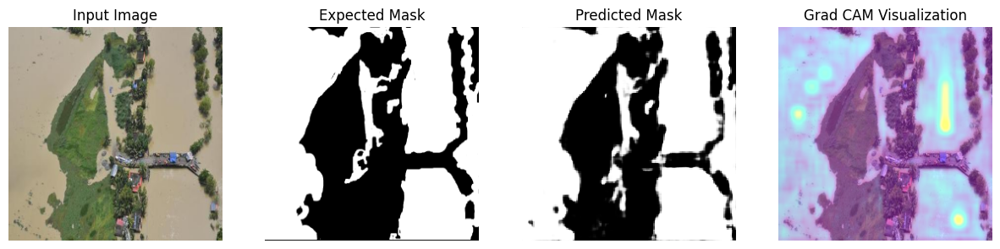

29/29 [==============================] - 8s 260ms/step - loss: 0.0314 - accuracy: 0.9677 - val_loss: 0.4451 - val_accuracy: 0.8989
Epoch 81/100
29/29 [==============================] - 7s 237ms/step - loss: 0.0313 - accuracy: 0.9678 - val_loss: 0.4559 - val_accuracy: 0.8999
Epoch 82/100
29/29 [==============================] - 7s 233ms/step - loss: 0.0309 - accuracy: 0.9680 - val_loss: 0.4398 - val_accuracy: 0.9002
Epoch 83/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0308 - accuracy: 0.9679 - val_loss: 0.4645 - val_accuracy: 0.8989
Epoch 84/100
29/29 [==============================] - 7s 236ms/step - loss: 0.0306 - accuracy: 0.9680 - val_loss: 0.4666 - val_accuracy: 0.8993
Epoch 85/100
29/29 [==============================] - 7s 231ms/step - loss: 0.0311 - accuracy: 0.9678 - val_loss: 0.4812 - val_accuracy: 0.9003
Epoch 86/100
29/29 [==============================] - 7s 234ms/step - loss: 0.0316 - accuracy: 0.9677 - val_loss: 0.4768 - val_accuracy: 0.9005
Epoch

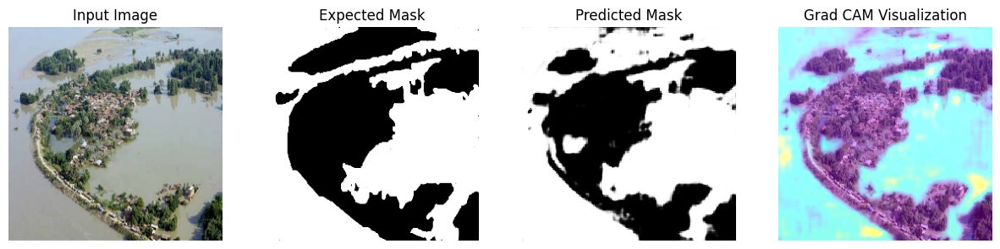

29/29 [==============================] - 7s 259ms/step - loss: 0.0311 - accuracy: 0.9678 - val_loss: 0.4632 - val_accuracy: 0.8973
Epoch 91/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0307 - accuracy: 0.9679 - val_loss: 0.4608 - val_accuracy: 0.8944
Epoch 92/100
29/29 [==============================] - 7s 231ms/step - loss: 0.0307 - accuracy: 0.9679 - val_loss: 0.4849 - val_accuracy: 0.8966
Epoch 93/100
29/29 [==============================] - 7s 237ms/step - loss: 0.0309 - accuracy: 0.9679 - val_loss: 0.4898 - val_accuracy: 0.8957
Epoch 94/100
29/29 [==============================] - 7s 226ms/step - loss: 0.0309 - accuracy: 0.9679 - val_loss: 0.4961 - val_accuracy: 0.8965
Epoch 95/100
29/29 [==============================] - 7s 231ms/step - loss: 0.0309 - accuracy: 0.9679 - val_loss: 0.4626 - val_accuracy: 0.8976
Epoch 96/100
29/29 [==============================] - 7s 225ms/step - loss: 0.0313 - accuracy: 0.9677 - val_loss: 0.4898 - val_accuracy: 0.8980
Epoch

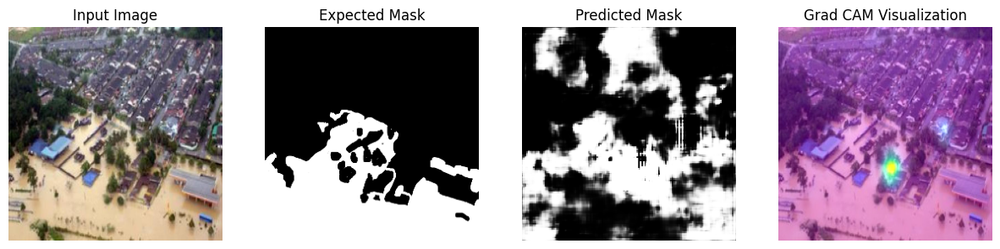

29/29 [==============================] - 7s 257ms/step - loss: 0.0759 - accuracy: 0.9527 - val_loss: 3.6056 - val_accuracy: 0.6306


In [49]:
# Compile
DeepLabV3.compile(
    loss='binary_crossentropy',
    optimizer="adam",
    metrics = ['accuracy']
)

# Callbacks
callbacks = [
    ModelCheckpoint(MODEL_NAME+".h5", save_best_only=True),
    ShowProgress()
]

# Train
history = DeepLabV3.fit(
    train_images, train_masks,
    validation_data=(test_images, test_masks),
    epochs=100,
    callbacks=callbacks,
    batch_size=8,
)

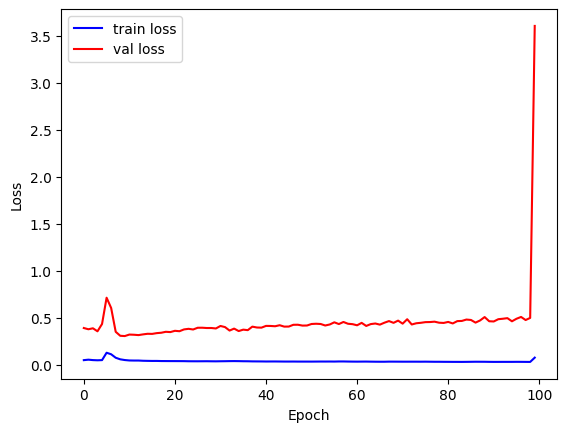

In [56]:
#pd.DataFrame(history.history).plot(figsize=(15,5))
#plt.ylim([0.0,1.0])

plt.plot(history.history['loss'], 'b-', label='train loss')
plt.plot(history.history['val_loss'], 'r-', label='val loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()



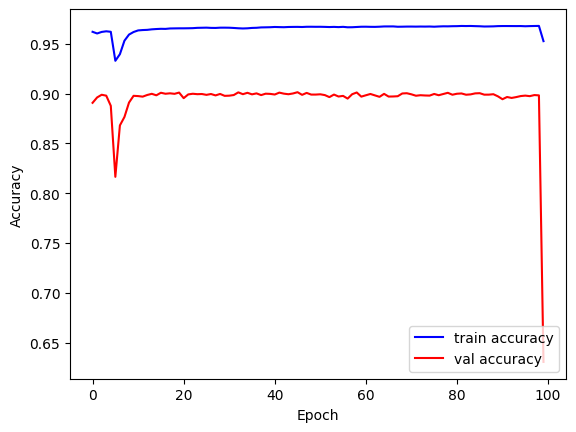

In [54]:
#pd.DataFrame(history.history).plot(figsize=(15,5))
#plt.ylim([0.0,1.0])

plt.plot(history.history['accuracy'], 'b-', label='train accuracy')
plt.plot(history.history['val_accuracy'], 'r-', label='val accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.show()

1/1 [==============================] - 0s 29ms/step


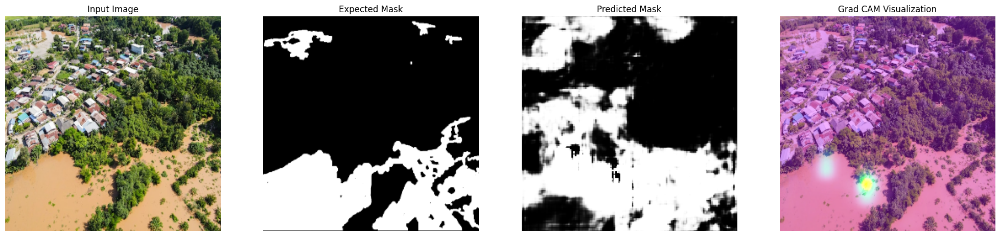

1/1 [==============================] - 0s 40ms/step


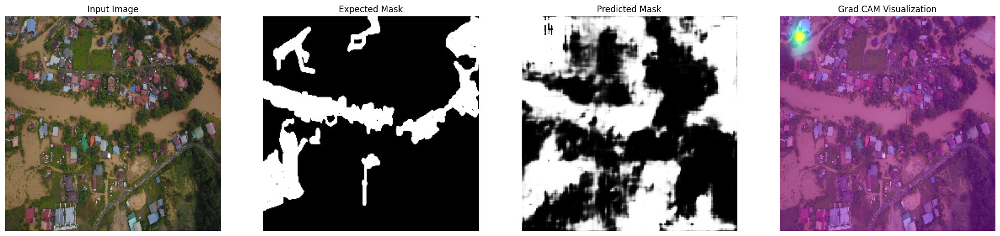

1/1 [==============================] - 0s 61ms/step


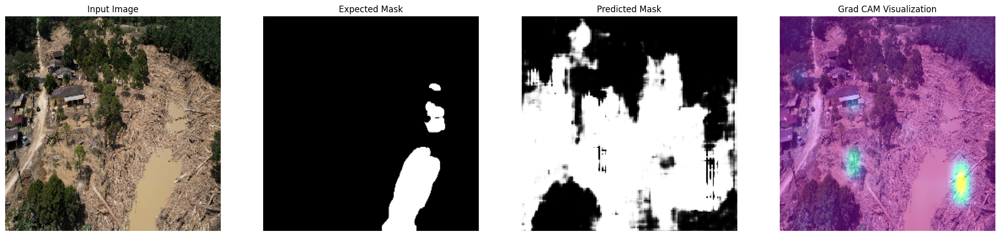

1/1 [==============================] - 0s 44ms/step


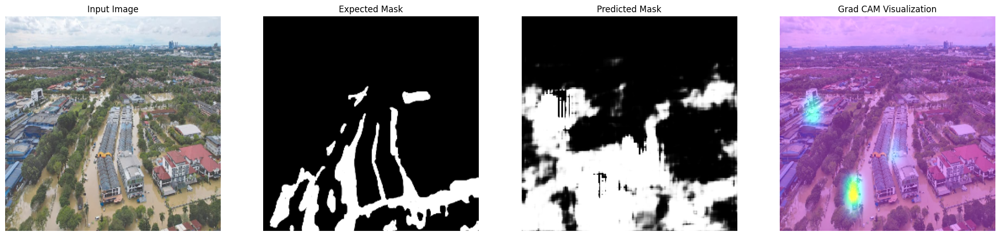

1/1 [==============================] - 0s 40ms/step


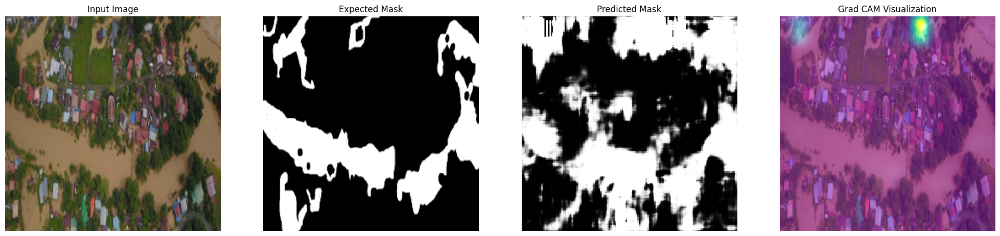

1/1 [==============================] - 0s 40ms/step


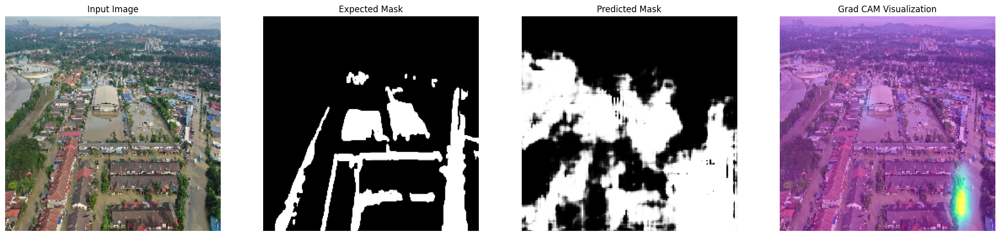

1/1 [==============================] - 0s 39ms/step


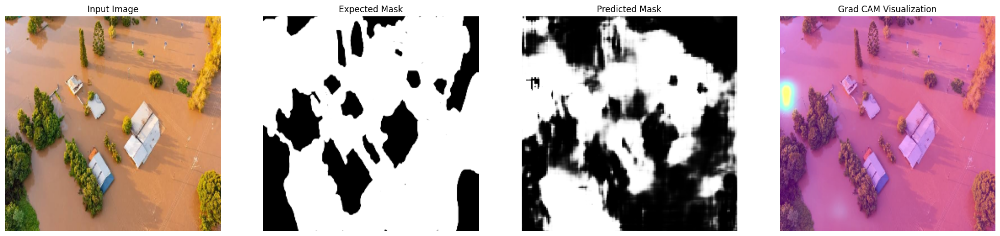

1/1 [==============================] - 0s 45ms/step


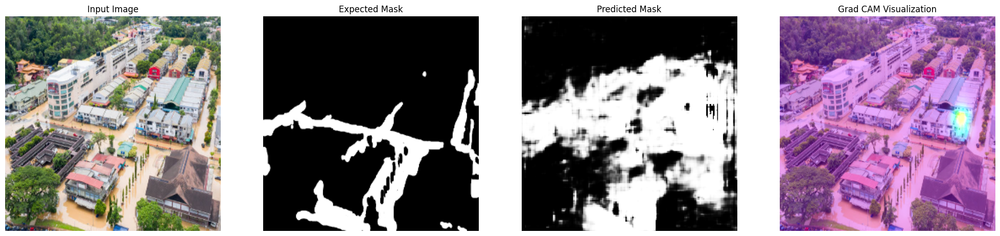

1/1 [==============================] - 0s 46ms/step


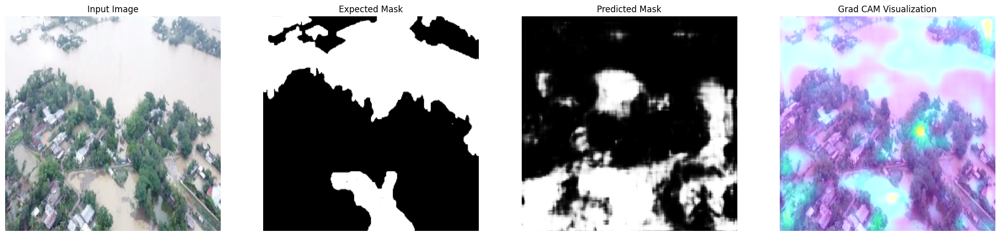

1/1 [==============================] - 0s 43ms/step


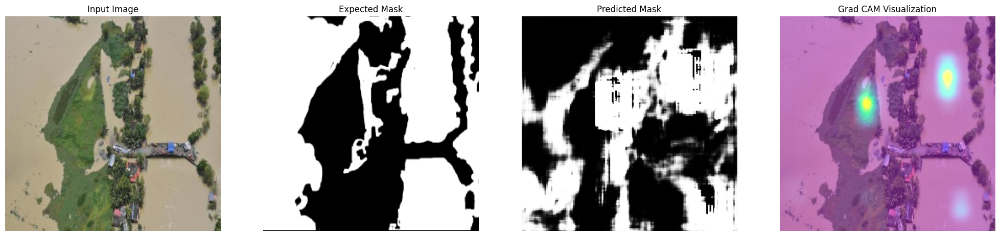

1/1 [==============================] - 0s 37ms/step


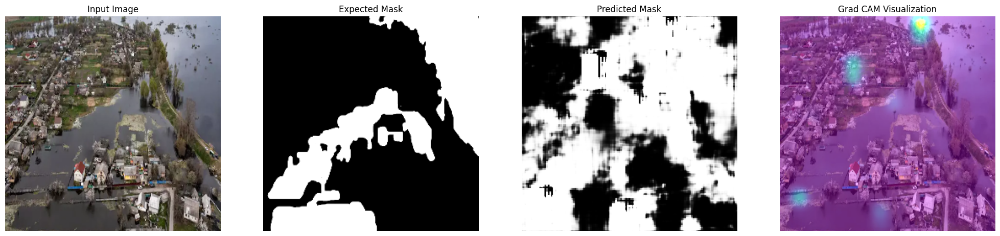

1/1 [==============================] - 0s 53ms/step


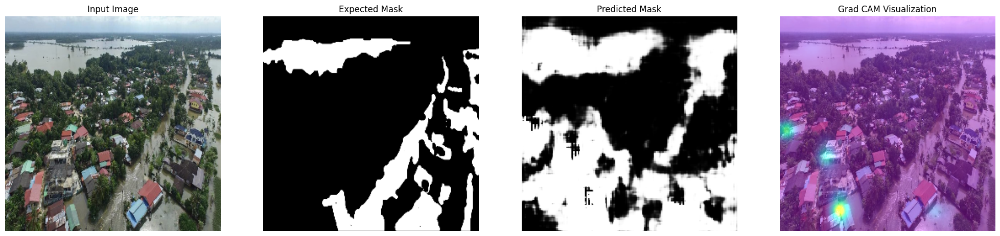

1/1 [==============================] - 0s 39ms/step


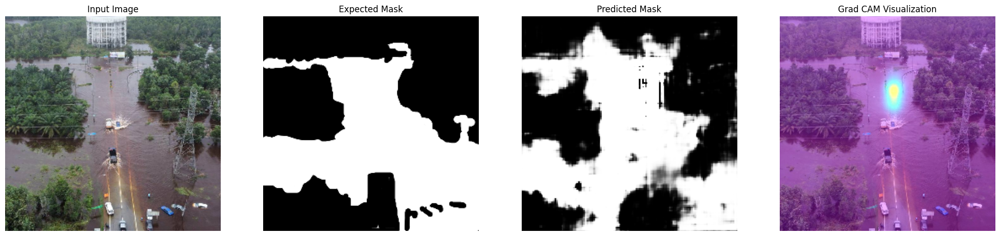

1/1 [==============================] - 0s 39ms/step


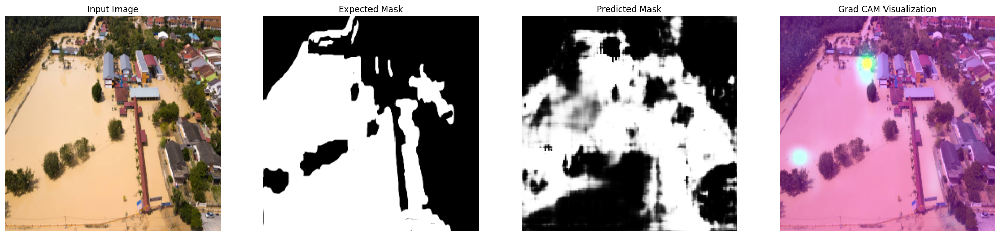

1/1 [==============================] - 0s 40ms/step


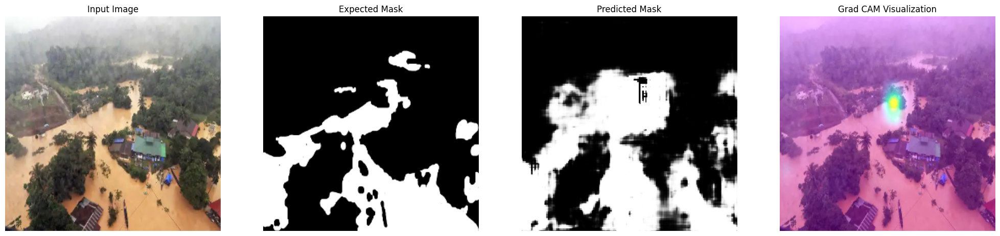

1/1 [==============================] - 0s 40ms/step


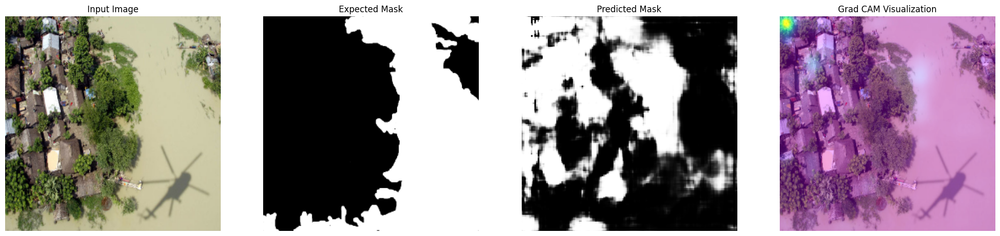

1/1 [==============================] - 0s 56ms/step


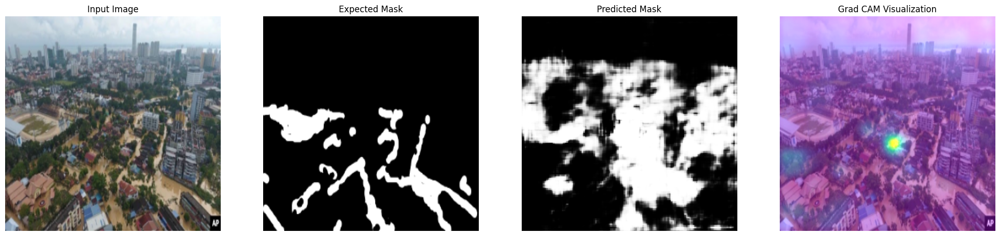

1/1 [==============================] - 0s 64ms/step


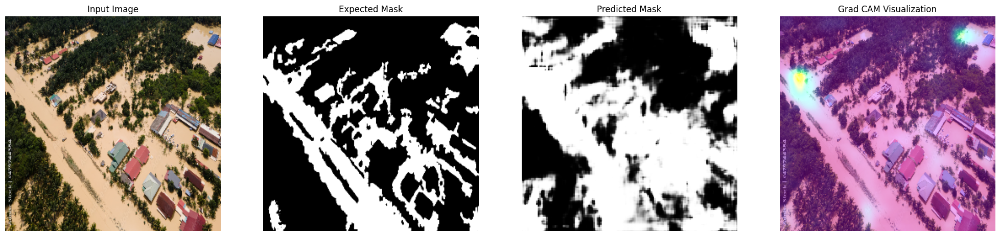

1/1 [==============================] - 0s 38ms/step


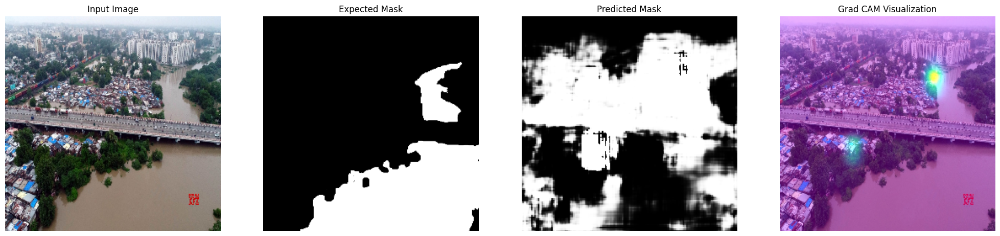

1/1 [==============================] - 0s 42ms/step


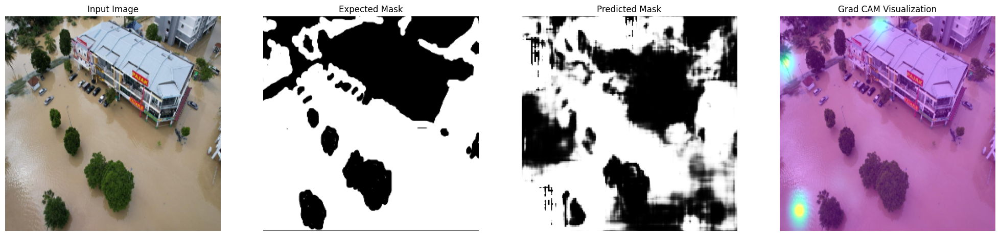

In [57]:
for i in range(20):
    show_model_preds(test_images, test_masks, model=DeepLabV3, SIZE=(25,8))

###The model predictions are not perfect but they are pretty close to be perfect, the model predictions are convincing and somtimes it seems like model is right and the true label is wrong. The predicted label maps lack the clarity or we can say that they lack the sharpness, but this was expected by the model. If you closely pay attention to the

In [58]:
from tensorflow.keras.models import load_model

# Define the custom layer "ConvBlock"
#import ConvBlock  # Replace 'your_module' with the actual module where ConvBlock is defined

# Register the custom layer when loading the model
custom_objects = {'ConvBlock': ConvBlock}

# Open the best model saved during training while specifying the custom_objects parameter
best_model = load_model("DeepLab-FloodArea.h5", custom_objects=custom_objects)
print('\nNeural network weights updated to the best epoch.')



Neural network weights updated to the best epoch.


In [60]:
# We use the evaluate function to evaluate the accuracy of our model in the test group
print(f"Accuracy in test group: {best_model.evaluate(test_images, test_masks, verbose=0)[1]}")

Accuracy in test group: 0.8978318572044373


#END